In [1]:
!pip install pandas
import numpy as np
import matplotlib.pyplot as plt
import glob
%matplotlib inline 

from skimage import io, color, filters, feature, restoration
from skimage.transform import resize, rotate
from skimage.color import rgb2gray
from scipy.spatial.distance import squareform
from scipy.misc import imread
import pandas as pd
import matplotlib.cm as cm
from scipy import ndimage, misc
import pickle

import sys
sys.path.append("..")

twisted 18.7.0 requires PyHamcrest>=1.9.0, which is not installed.
tensorboard 2.0.1 has requirement setuptools>=41.0.0, but you'll have setuptools 40.2.0 which is incompatible.
jupyterlab-server 1.0.0 has requirement jsonschema>=3.0.1, but you'll have jsonschema 2.6.0 which is incompatible.
google-auth 1.7.0 has requirement setuptools>=40.3.0, but you'll have setuptools 40.2.0 which is incompatible.
You are using pip version 18.1, however version 19.3.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [2]:
from src.standardizer import Standardizer
from src.imageData_generator import ImageGenerator

In [3]:
resized_imgs = glob.glob('../data/medium/*')

In [4]:

img_list = [164, 202, 425, 345, 139, 72, 311, 363, 403, 509, 362, 257, 175, 203, 47, 183, 0, 297, 34, 8, 320, 197, 293, 450, 215, 28, 74]

In [5]:
img_subset = []
for img in resized_imgs:
    img_idx = int(img.split('/')[3].split('_')[0])
    if img_idx in img_list:
        img_subset.append(img)

In [6]:
img_subset

['../data/medium/164_img.png',
 '../data/medium/202_img.png',
 '../data/medium/425_img.png',
 '../data/medium/345_img.png',
 '../data/medium/139_img.png',
 '../data/medium/72_img.png',
 '../data/medium/311_img.png',
 '../data/medium/363_img.png',
 '../data/medium/403_img.png',
 '../data/medium/509_img.png',
 '../data/medium/362_img.png',
 '../data/medium/257_img.png',
 '../data/medium/175_img.png',
 '../data/medium/203_img.png',
 '../data/medium/47_img.png',
 '../data/medium/183_img.png',
 '../data/medium/0_img.png',
 '../data/medium/297_img.png',
 '../data/medium/34_img.png',
 '../data/medium/8_img.png',
 '../data/medium/320_img.png',
 '../data/medium/197_img.png',
 '../data/medium/293_img.png',
 '../data/medium/450_img.png',
 '../data/medium/215_img.png',
 '../data/medium/28_img.png',
 '../data/medium/74_img.png']

In [7]:
standardizer_subset = Standardizer(img_subset, resized_imgs[3])

In [8]:
standardizer_subset.binarized_images

array([[[0., 0., 0., ..., 1., 1., 1.],
        [0., 0., 0., ..., 1., 1., 1.],
        [0., 0., 0., ..., 1., 1., 0.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [0., 0., 0., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [0., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       ...,

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1.

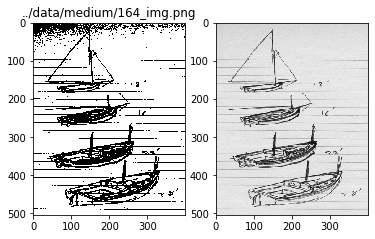

0


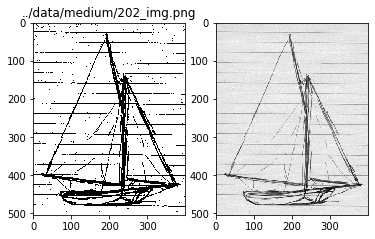

1


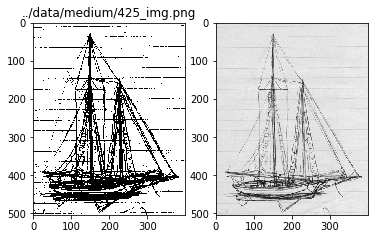

2


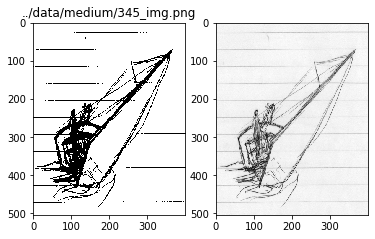

3


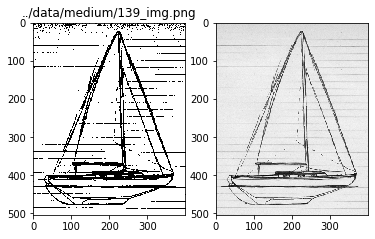

4


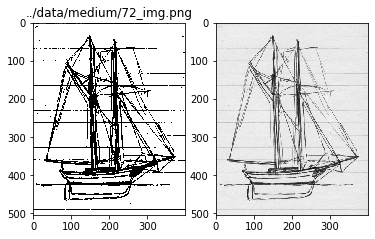

5


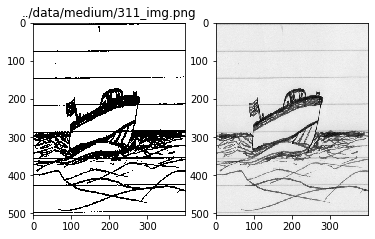

6


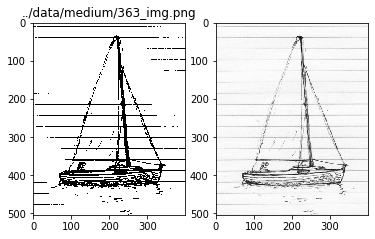

7


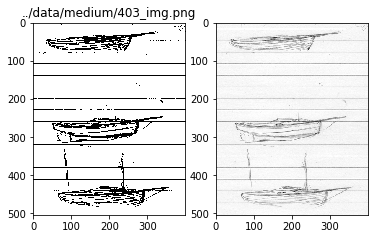

8


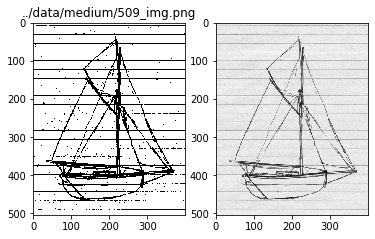

9


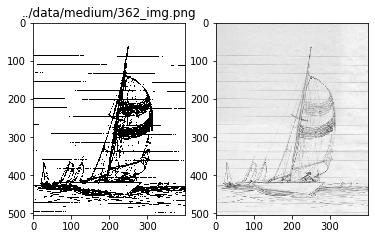

10


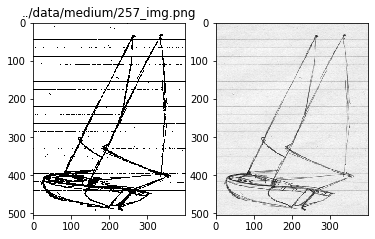

11


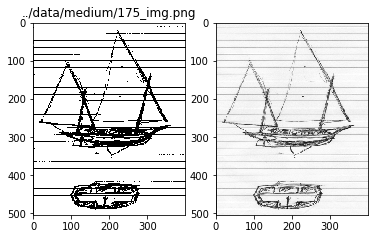

12


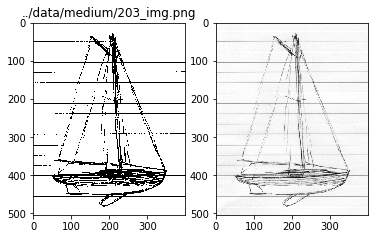

13


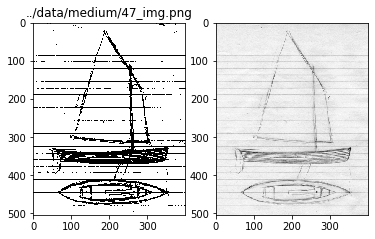

14


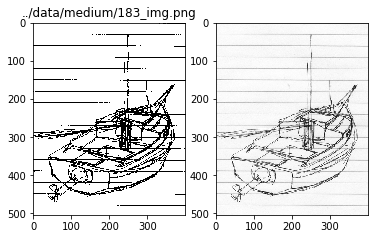

15


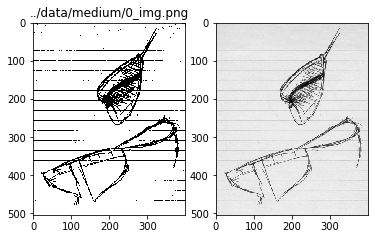

16


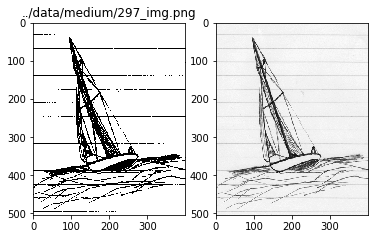

17


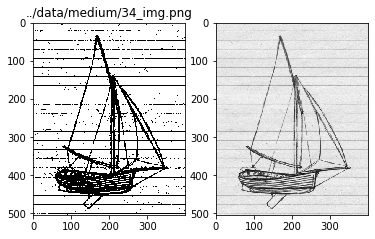

18


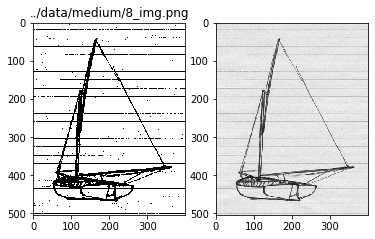

19


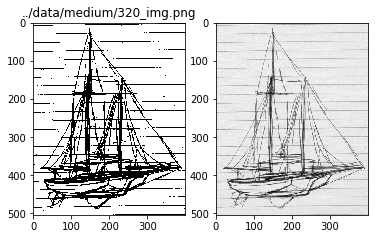

20


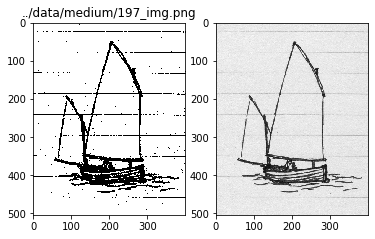

21


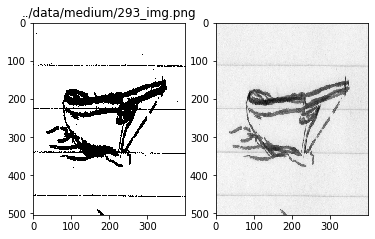

22


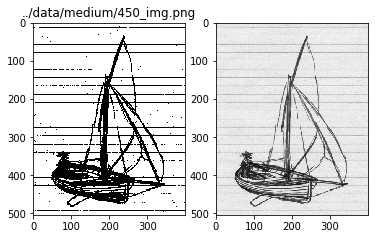

23


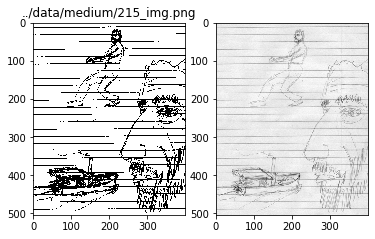

24


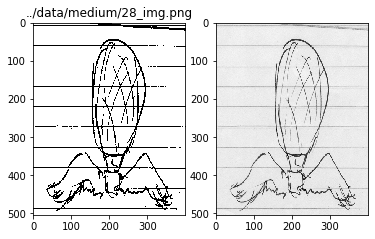

25


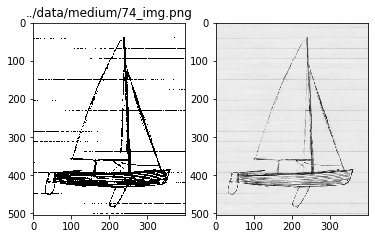

26


In [9]:
for i in range(len(img_subset)):
    fig, ax = plt.subplots(1, 2)
    ax[0].imshow(standardizer_subset.binarized_images[i], cmap='gray')
    ax[1].imshow(standardizer_subset.greyscale_image_list[i], cmap='gray')
    ax[0].set_title(standardizer_subset.image_list[i])
    plt.show()
    print(i)

In [98]:
bin_image = standardizer_subset.binarized_images[3]
grey_image = standardizer_subset.greyscale_image_list[3]
img_name = standardizer_subset.image_list[3].split('/')[3].split('.')[0]


In [99]:
len(standardizer_subset.greyscale_image_list)

27

Whitespace


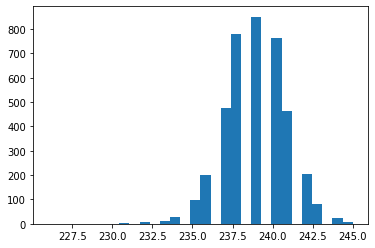

In [100]:
arr = np.array(grey_image)
first10_flat = arr[:10, :].flatten()
n, bins, patches = plt.hist(first10_flat, bins=30)
bin_max = np.where(n == n.max())
whitespace = bins[bin_max][0]

Will average whitespace intensity (general shade of the image) impact classification/CNN models? We will see
- if it does: create different models for different shade groups

In [101]:
images = ImageGenerator(bin_image, grey_image, img_name)
images.pad(15, whitespace)

In [102]:
gray = images.gray_padded_image
binar = images.bin_padded_image

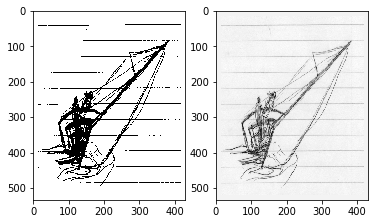

In [103]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(binar, cmap='gray')
ax[1].imshow(gray, cmap='gray')

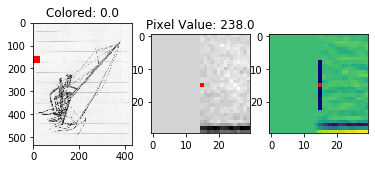

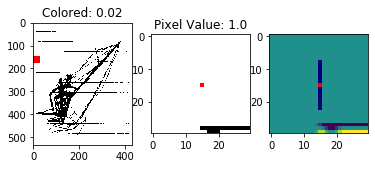

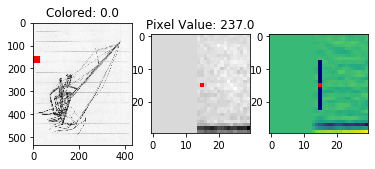

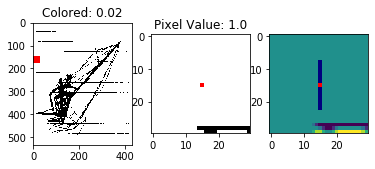

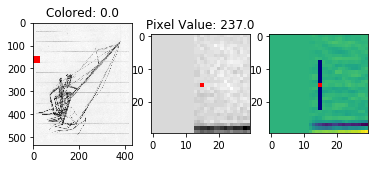

...

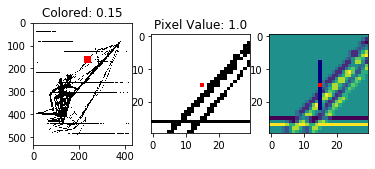

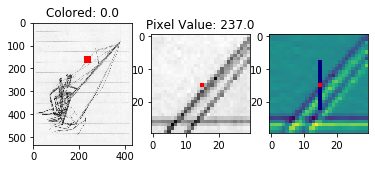

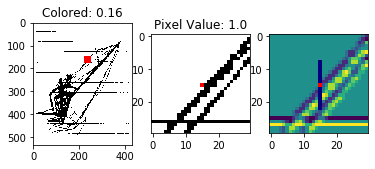

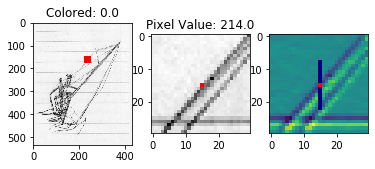

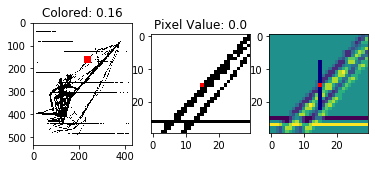

fdas
0


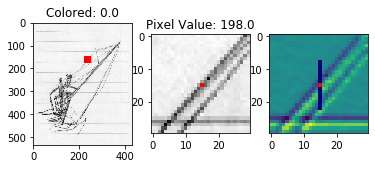

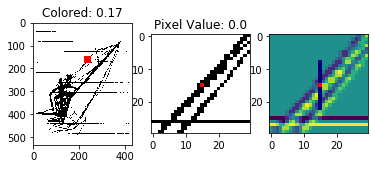

fdas
0


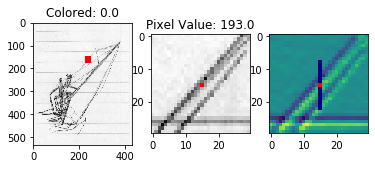

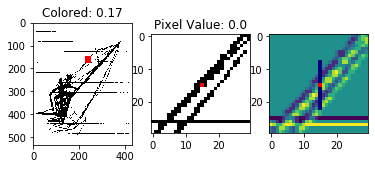

fdas
0


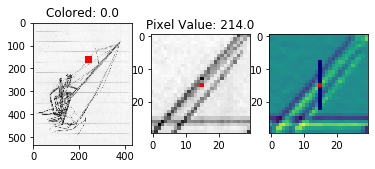

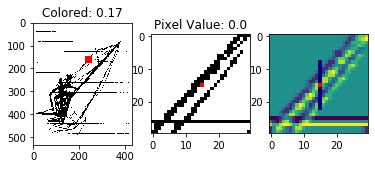

dfs
0


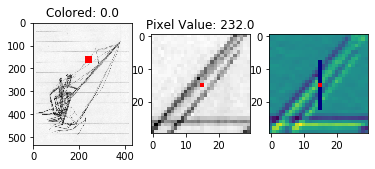

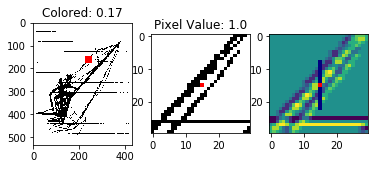

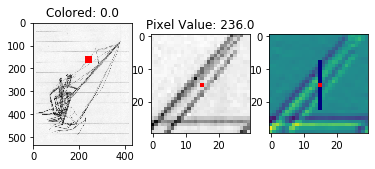

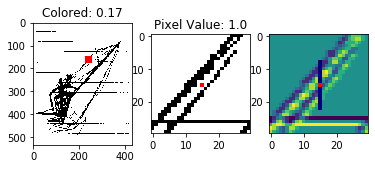

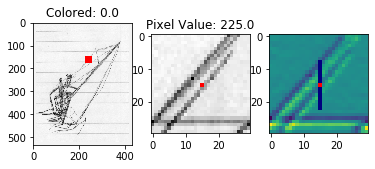

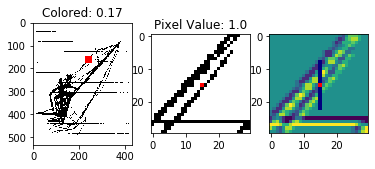

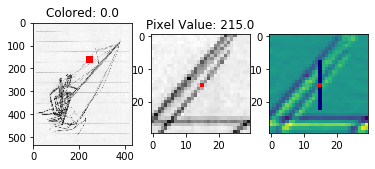

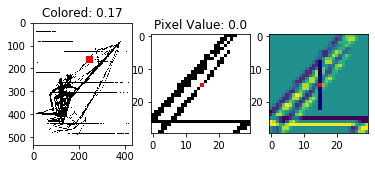

fdsa
0


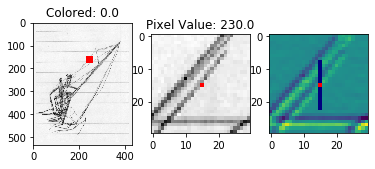

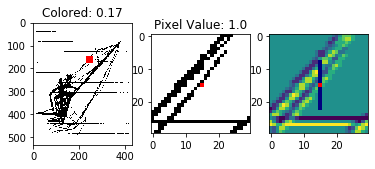

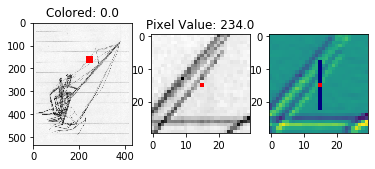

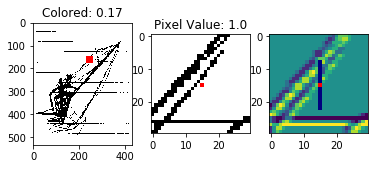

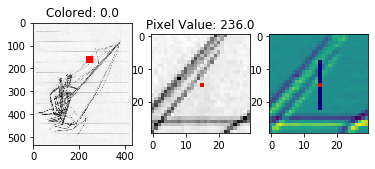

...

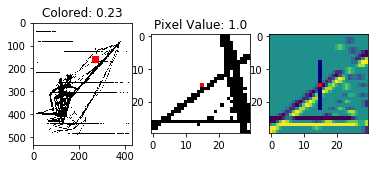

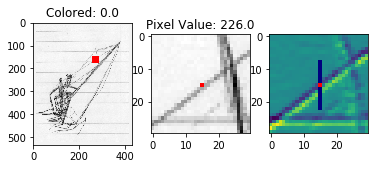

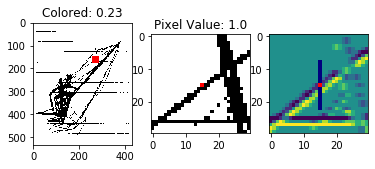

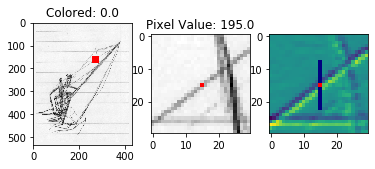

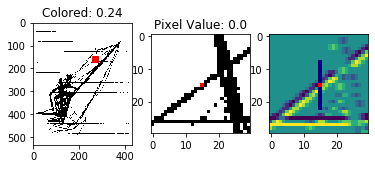

fads
0


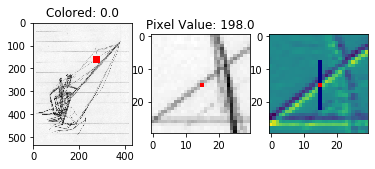

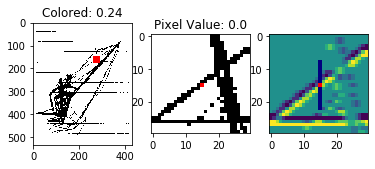

gdfas
0


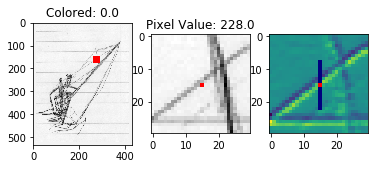

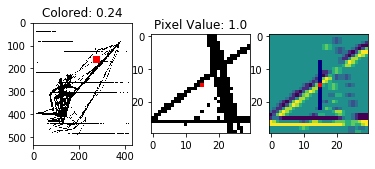

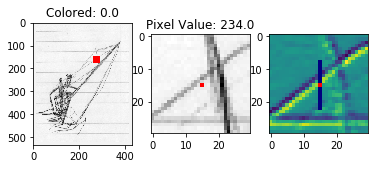

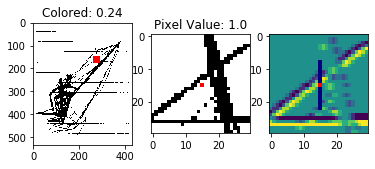

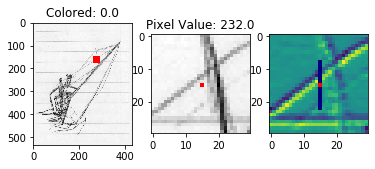

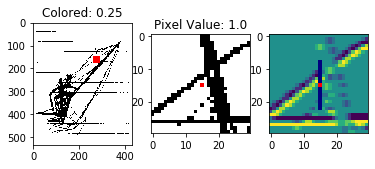

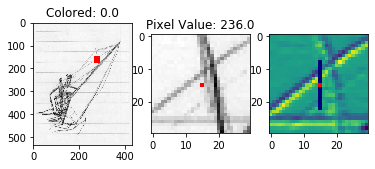

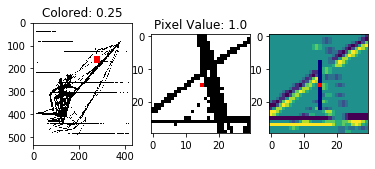

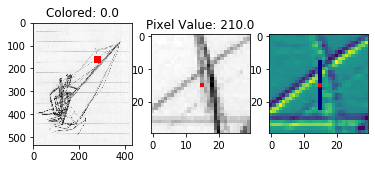

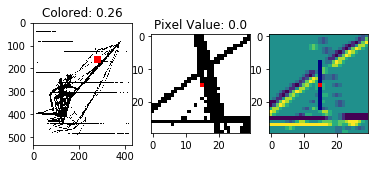

fads
0


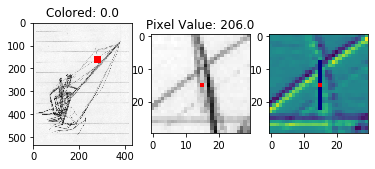

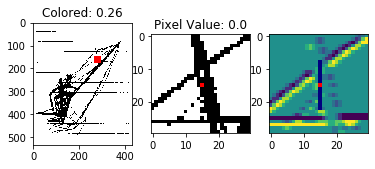

gfdas
0


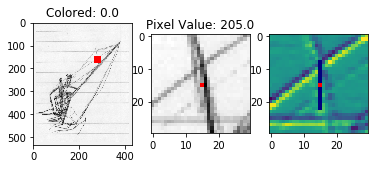

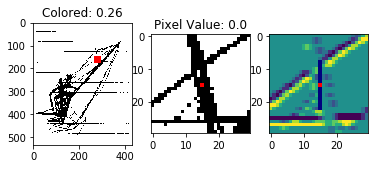

fgdas
0


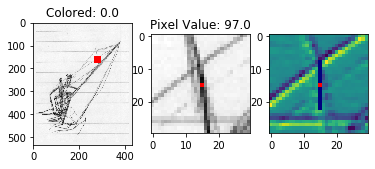

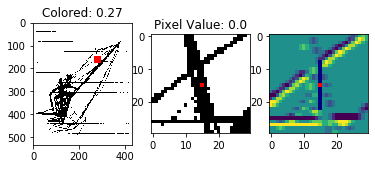

gdfas
0


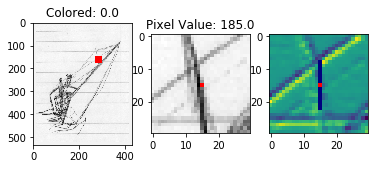

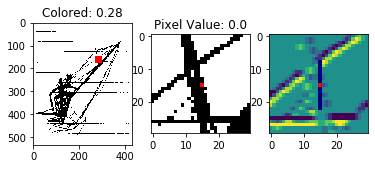

dfgsa
0


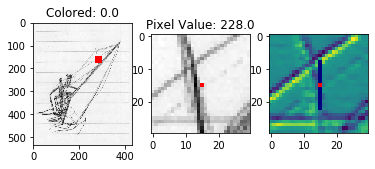

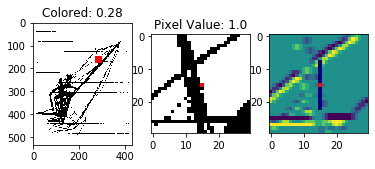

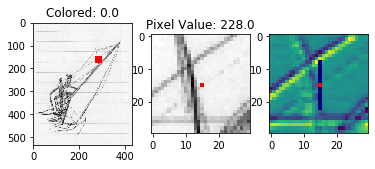

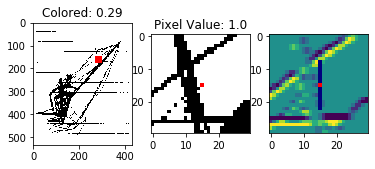

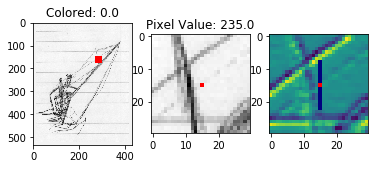

...

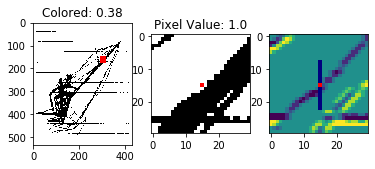

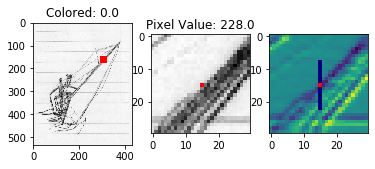

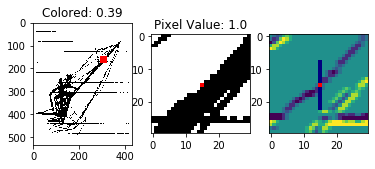

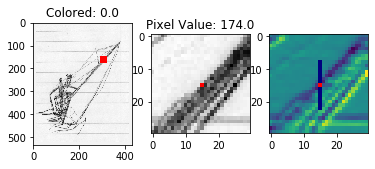

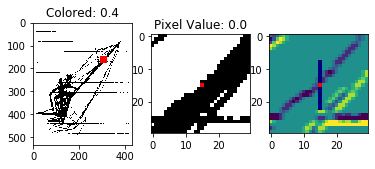

dfsa
0


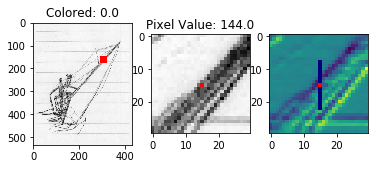

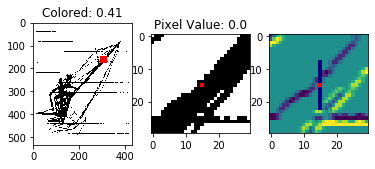

dfsa
0


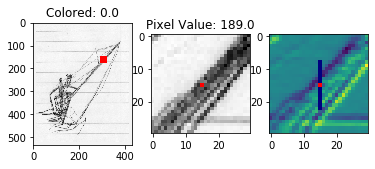

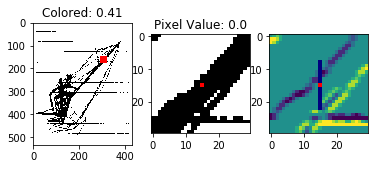

gfdas
0


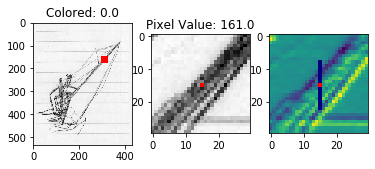

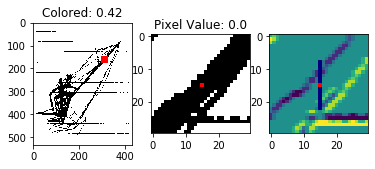

fdas
0


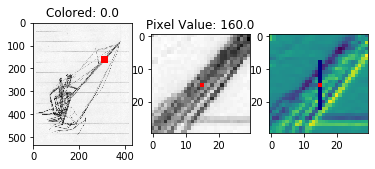

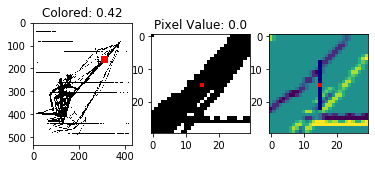

fdgas
0


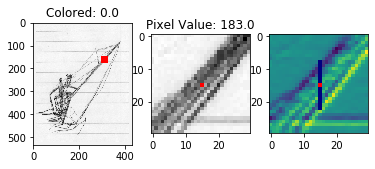

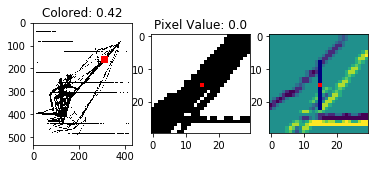

fdgas
0


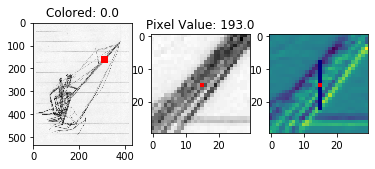

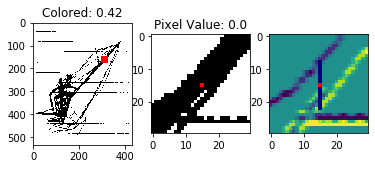

fads
0


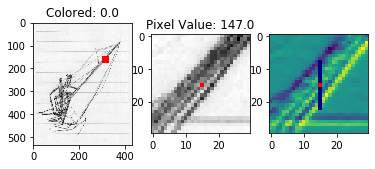

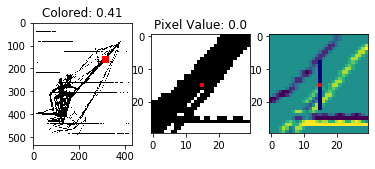

fdgas
0


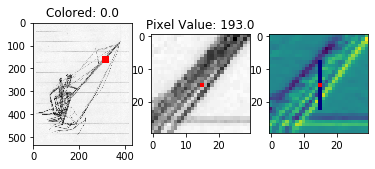

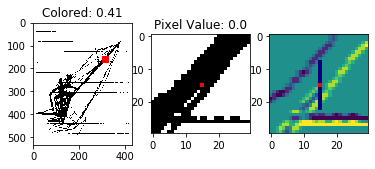

fgads
0


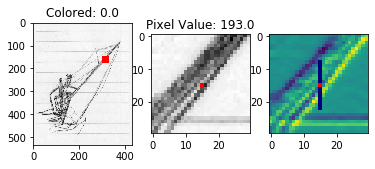

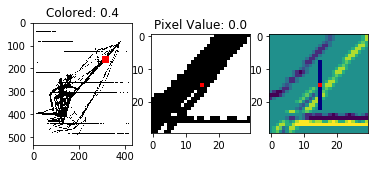

fgdas
0


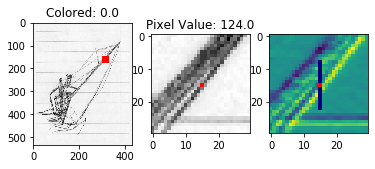

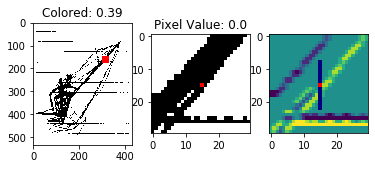

gfdas
0


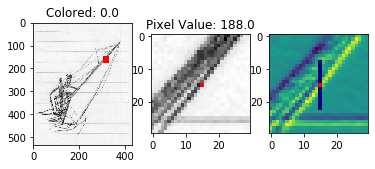

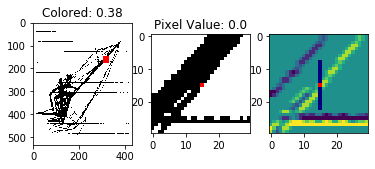

fgdas
0


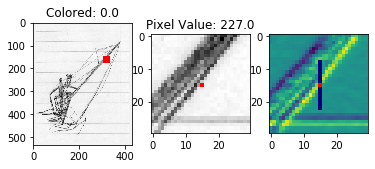

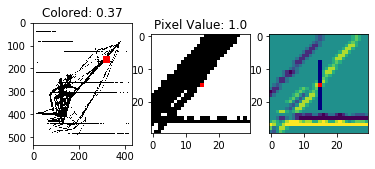

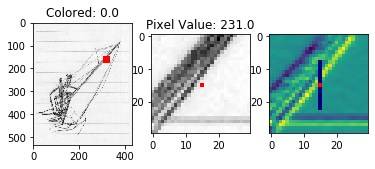

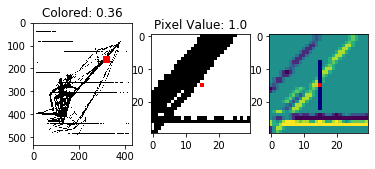

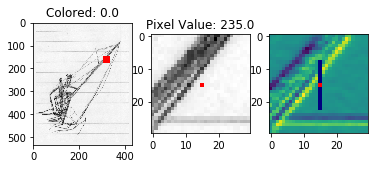

...

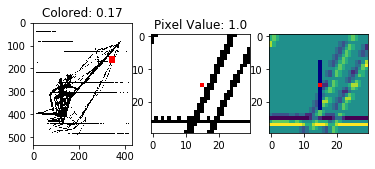

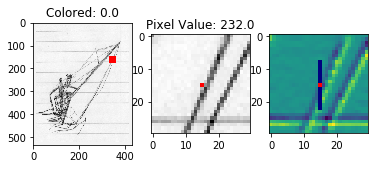

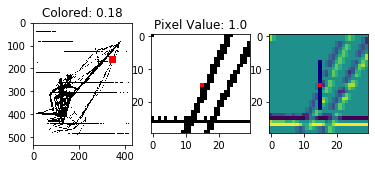

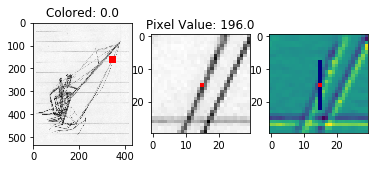

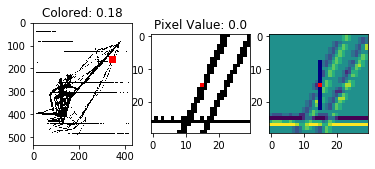

dsfa
0


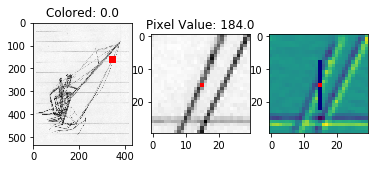

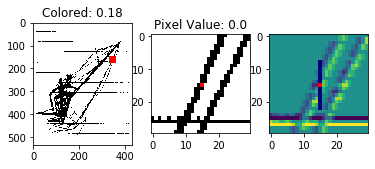

asdf
0


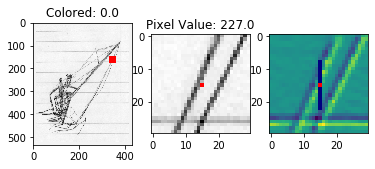

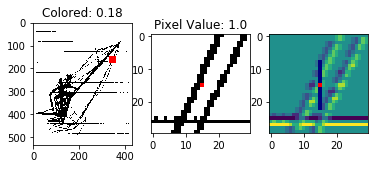

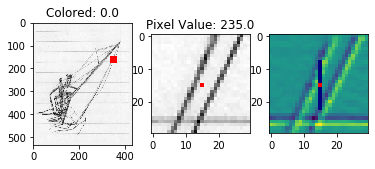

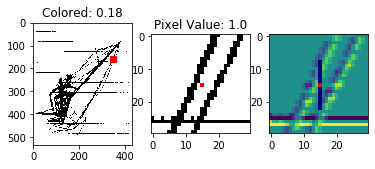

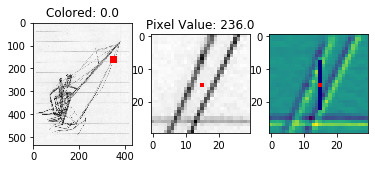

...

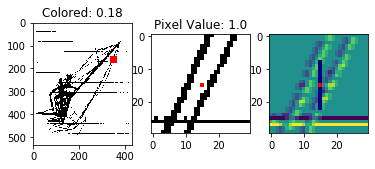

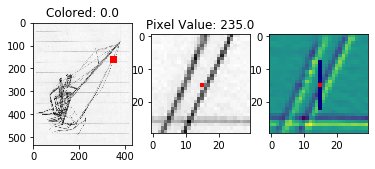

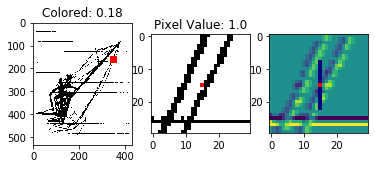

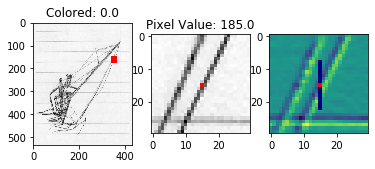

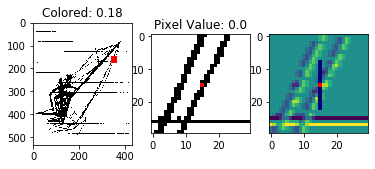

fdgas
0


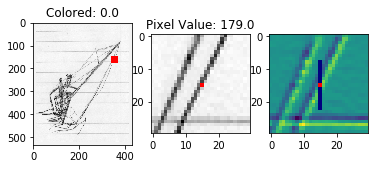

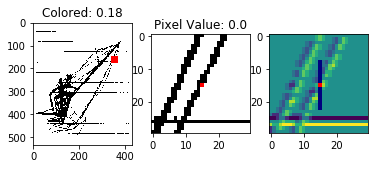

dfgas
0


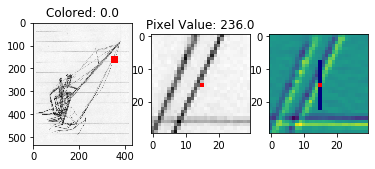

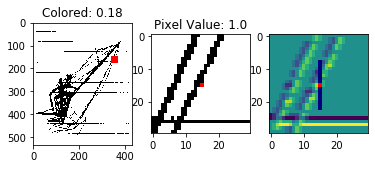

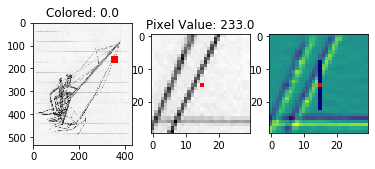

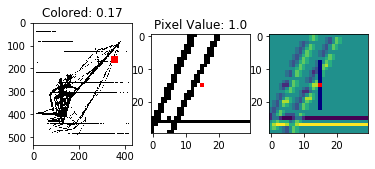

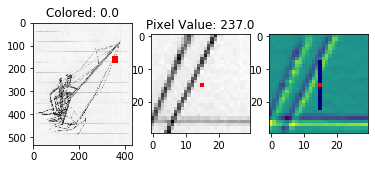

...

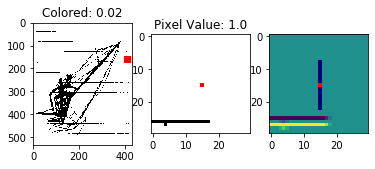

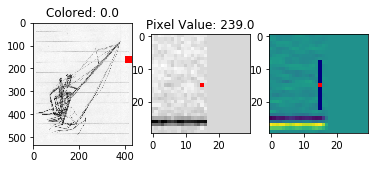

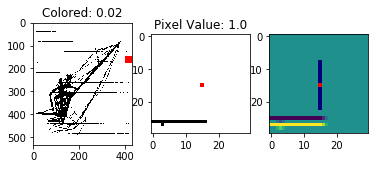

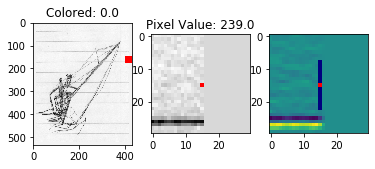

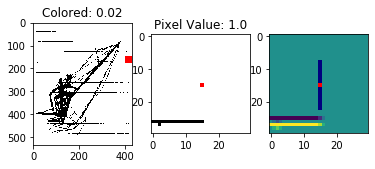

In [107]:
images.gen_data(146)

In [16]:
def plot_frame(zoom, row_index, col_index, size):
    masked_window = np.random.random((zoom.shape[0],zoom.shape[1]))
    masked_window[row_index:row_index+size, col_index:col_index+size] = 1
    masked_window = np.ma.masked_where(masked_window != 1, masked_window)

    masked_pixel = np.random.random((zoom[row_index:row_index+size, col_index:col_index+size].shape[0],zoom[row_index:row_index+size, col_index:col_index+size].shape[1]))
    masked_pixel[15,15] = 1
    masked_pixel = np.ma.masked_where(masked_pixel != 1, masked_pixel)

    masked_pixel1 = np.random.random((zoom[row_index:row_index+size, col_index:col_index+size].shape[0],zoom[row_index:row_index+size, col_index:col_index+size].shape[1]))
    masked_pixel1[8:23, 15] = 1
    masked_pixel1 = np.ma.masked_where(masked_pixel1 != 1, masked_pixel1)
    
    window = zoom[row_index:row_index+size, col_index:col_index+size]
    colored_percentage = np.count_nonzero(window==0)/(30**2)
    pixel_value = window[15, 15]
    window_sobel = ndimage.sobel(window, axis=0)
    above_area = np.mean(window_sobel[8:16, 15])
    below_area = np.mean(window_sobel[16:23, 15])
    sobel_value = window_sobel[15, 15]
    
    # Overlay the two images
    fig, ax = plt.subplots(1, 3)
    ax.ravel()
    ax[0].imshow(zoom, cmap='gray')
    ax[0].imshow(masked_window, cmap='prism', interpolation='none')
    # ax[0].imshow(masked_pixel, cmap=cm.jet, interpolation='none')
    ax[0].set_title('Colored: {}'.format(round(colored_percentage, 2)))
    ax[1].imshow(window, cmap='gray')
    ax[1].imshow(masked_pixel, cmap='prism', interpolation='none')
    ax[1].set_title('Pixel Value: {}'.format(pixel_value))
    ax[2].imshow(window_sobel)
    ax[2].imshow(masked_pixel1, cmap='jet')
    ax[2].imshow(masked_pixel, cmap='prism', interpolation='none')
#     return above_area, below_area, colored_percentage


def get_label():
    label = input()
    if label == 'l':
        label_for_entry = 1
    elif label == '':
        label_for_entry = 1
    else:
        label_for_entry = 0
    return label_for_entry



def update_dict(my_dict, gray_pixel_value, mean_pixel_value, colored_percentage, sobel_gradient, label):
    my_dict['gray_pixel_value'].append(gray_pixel_value)
    my_dict['mean_gray_pixel_value'].append(mean_pixel_value)
    my_dict['bin_percentage_colored'].append(colored_percentage)
    my_dict['sobel_gradient'].append(sobel_gradient)
    my_dict['label'].append(label)
#     return my_dict

def add_label_history(df):
    df['label_t1'] = ""
    df['label_t2'] = ""
    df['label_t3'] = ""
    for idx, row in df.iterrows():
        if idx > 0:
            df.at[idx,'label_t1'] = list(df[df.index == idx - 1].label)[0]
            if idx > 1:
                df.at[idx,'label_t2'] = list(df[df.index == idx - 2].label)[0]
                if idx > 2:
                    df.at[idx,'label_t3'] = list(df[df.index == idx - 3].label)[0]

def gen_data(row):  
    my_dict = {'sobel_above': [], 'sobel_below': [], 'percentage_colored': [], 'label': []}
    for i in range(1, 900):
        size = 30
        row_index = row
        col_index = i
        plot_frame(zoom, row_index, col_index, size)
        plt.show()
        window = zoom[row_index:row_index+size, col_index:col_index+size]
        colored_percentage = np.count_nonzero(window==0)/(30**2)
        above_area = np.mean(window_sobel[8:16, 15])
        below_area = np.mean(window_sobel[16:23, 15])
        pixel_value = window[15, 15]
        if pixel_value == 0.0:
            label = get_label()
            update_dict(my_dict, above_area, below_area, colored_percentage, label)
    df = pd.DataFrame.from_dict(my_dict)
    add_label_history(df)
    return df

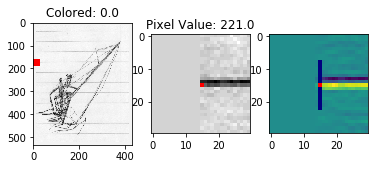

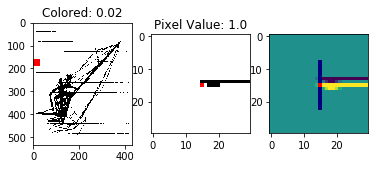

/Users/reiffd/anaconda3/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:78: UserWarning: Float image out of standard range; displaying image with stretched contrast.
  warn("Float image out of standard range; displaying "


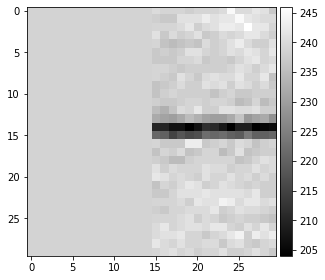

In [105]:
my_dict = {'gray_pixel_value': [], 'mean_gray_pixel_value': [], 'bin_percentage_colored': [], 'sobel_gradient': [], 'label': []}

size = 30
row_idx = 159
col_idx = 0
plot_frame(gray, row_idx, col_idx, size)
plot_frame(binar, row_idx, col_idx, size)
plt.show()
gray_window = gray[row_idx:row_idx+size, col_idx:col_idx+size]
io.imshow(gray_window, cmap='gray')
bin_window = binar[row_idx:row_idx+size, col_idx:col_idx+size]
gray_pixel_value = gray_window[15, 15]
bin_pixel_value = bin_window[15, 15]
mean_pixel_value = np.mean(gray_window)
gray_window_sobel = ndimage.sobel(gray_window, axis=0)
colored_percentage = np.count_nonzero(bin_window==0)/(30**2)
above_area = np.mean(gray_window_sobel[8:16, 15])
below_area = np.mean(gray_window_sobel[16:23, 15])
sobel_gradient = above_area - -below_area
# if bin_pixel_value == 0.0:
#     label = get_label()
#     update_dict(my_dict, gray_pixel_value, mean_pixel_value, colored_percentage, sobel_gradient, label)
            
            
# print(my_dict)
# io.imshow(bin_window, cmap='gray')


In [45]:
## Window EDA

In [40]:
gray_lines = glob.glob('../data/gray/all/lines/*')
gray_drawings = glob.glob('../data/gray/all/drawings/*')

In [41]:
images_array_D = []
for image in gray_drawings:
    images_array_D.append(imread(image, mode='L'))
images_array_D = np.array(images_array_D)

images_array = []
for image in gray_lines:
    images_array.append(imread(image, mode='L'))
images_array = np.array(images_array)

/Users/reiffd/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/reiffd/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  


In [42]:
average_pixel_line = np.zeros((30, 30))
for i in range(30):
    for j in range(30):
        average_pixel_line[i, j] = np.mean(images_array[:, i, j])

average_pixel_drawing = np.zeros((30, 30))
for i in range(30):
    for j in range(30):
        average_pixel_drawing[i, j] = np.mean(images_array_D[:, i, j])

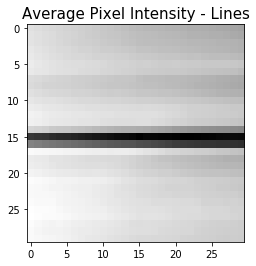

In [43]:
fig, ax = plt.subplots()
ax.imshow(average_pixel_line, cmap= 'gray')
ax.set_title('Average Pixel Intensity - Lines', fontsize=15)
fig.savefig('../data/after4.png')

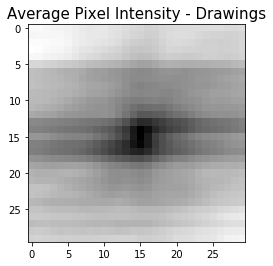

In [44]:
fig, ax = plt.subplots()
ax.imshow(average_pixel_drawing, cmap= 'gray')
ax.set_title('Average Pixel Intensity - Drawings', fontsize=15)
fig.savefig('../data/after4_draw.png')